In [2]:
import rp
import source.peekaboo as peekaboo
from source.peekaboo import run_peekaboo
from source.clip import get_clip_logits

[INFO] sd.py: loading stable diffusion...please make sure you have run `huggingface-cli login`.
Checkpoint path CompVis/stable-diffusion-v1-4


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


[INFO] sd.py: loaded stable diffusion!


In [2]:
!huggingface-cli whoami

SuryaaSeran


In [3]:
#Mario vs Luigi Part 1
results_collection=[]

In [3]:
def get_clip_logits_per_image(prompt, images):
    return [get_clip_logits(image, [prompt])[0] for image in images]

def random_colors(length=100):
    return [rp.random_rgb_float_color() for _ in range(length)]

def get_score(foreground, alpha, prompt:str, colors:list):
    
    alpha=alpha>.5
    rp.display_image(rp.blend_images(rp.random_rgb_float_color(),rp.cv_resize_image(foreground,rp.get_image_dimensions(alpha)),alpha))
    alpha=rp.cv_dilate(alpha,5,circular=True)
    
    assert rp.is_image(foreground) and rp.is_image(alpha)
    images = [rp.blend_images(foreground, color, alpha) for color in colors]
    scores = get_clip_logits_per_image(prompt, images)
    score = rp.mean(scores)
    return score

In [4]:
def ranked_results(results):
    colors = random_colors()
    def score(result):
        output = get_score(foreground = result.image,
                         alpha = result.alphas[0],
                         prompt = result.p_name,
                         colors = colors,
                        )
        print(output)
        return output
    scores = list(map(score,results))
    scores, results = rp.sync_sort(scores, results)
    
    #First is best
    scores, results = scores[::-1], results[::-1]
    
    return scores, results

def display_ranked_results(scores, results):
    for score, result in zip(scores, results):
        rp.display_image(
            rp.labeled_image(
                rp.horizontally_concatenated_images(
                    rp.cv_resize_image(result.image, (256, 256)), result.alphas[0]
                ),
                "%s : %f" % (result.p_name, score),
            )
        )

In [6]:
results=run_peekaboo('Luigi',
                         "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                         representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, GRAVITY=.05,
                         min_step=200,
                         max_step=400,
                         NUM_ITER=100,
                         )

Once 
 
 Loop 
 
 Reflect

ic| name: 'Luigi'
    label: SimpleLabel(name=Luigi)
    image_path: 'https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 100
    GUIDANCE_SCALE: 200
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}


Saved results at peekaboo_results/Luigi/028


In [14]:
from source.peekaboo import SimpleLabel

SimpleLabel('mario').name, SimpleLabel('mario').embedding

('mario',
 tensor([[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
          [-0.3711, -1.4497, -0.3401,  ...,  0.9489,  0.1867, -1.1034],
          [-0.5107, -1.4629, -0.2926,  ...,  1.0419,  0.0701, -1.0284],
          ...,
          [ 0.5006, -0.9552, -0.6610,  ...,  1.6013, -1.0622, -0.2191],
          [ 0.4988, -0.9451, -0.6656,  ...,  1.6467, -1.0858, -0.2088],
          [ 0.4923, -0.8124, -0.4912,  ...,  1.6108, -1.0174, -0.2484]],
 
         [[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
          [ 0.3587,  0.8557,  0.1581,  ...,  1.0682, -0.2872,  0.6135],
          [ 0.2444,  1.1318, -0.8721,  ...,  0.7299,  0.1295, -0.8538],
          ...,
          [ 0.7123,  0.1933, -0.6523,  ...,  1.0063, -0.0789, -0.1796],
          [ 0.6984,  0.1880, -0.6491,  ...,  1.0323, -0.0946, -0.1799],
          [ 0.6629,  0.2300, -0.5776,  ...,  0.9945, -0.0853, -0.2324]]],
        device='cuda:0'))

In [41]:
name = 'Mario'

In [19]:
label = SimpleLabel(name)
image=rp.load_image('https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg')
square_image_method='crop'

In [21]:
image.shape

(500, 500, 3)

In [33]:
image

array([[[ 66,  77, 221],
        [ 66,  77, 221],
        [ 65,  75, 222],
        ...,
        [ 62,  60, 223],
        [ 62,  60, 223],
        [ 62,  60, 223]],

       [[ 64,  74, 221],
        [ 64,  74, 221],
        [ 63,  73, 222],
        ...,
        [ 62,  60, 223],
        [ 62,  60, 223],
        [ 62,  60, 223]],

       [[ 59,  69, 218],
        [ 58,  68, 218],
        [ 57,  67, 217],
        ...,
        [ 62,  60, 223],
        [ 62,  60, 223],
        [ 62,  60, 223]],

       ...,

       [[103, 181,  95],
        [104, 182,  96],
        [105, 180,  95],
        ...,
        [134, 185, 119],
        [135, 186, 120],
        [136, 187, 121]],

       [[103, 181,  95],
        [103, 181,  95],
        [104, 179,  94],
        ...,
        [133, 184, 118],
        [133, 184, 118],
        [133, 184, 118]],

       [[102, 180,  94],
        [103, 181,  95],
        [104, 179,  94],
        ...,
        [134, 185, 119],
        [133, 184, 118],
        [132, 183, 117]]

In [29]:
import rp
help(rp.is_image)

Help on function is_image in module rp.r:

is_image(image)
    #region Image Channel Conversions



In [32]:
from source.peekaboo import *
make_image_square(image,square_image_method)

array([[[0.259, 0.302, 0.867],
        [0.259, 0.302, 0.867],
        [0.255, 0.294, 0.87 ],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       [[0.251, 0.291, 0.867],
        [0.251, 0.291, 0.867],
        [0.248, 0.287, 0.87 ],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       [[0.232, 0.272, 0.856],
        [0.229, 0.268, 0.856],
        [0.225, 0.264, 0.852],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       ...,

       [[0.404, 0.71 , 0.373],
        [0.407, 0.713, 0.376],
        [0.411, 0.706, 0.373],
        ...,
        [0.525, 0.725, 0.467],
        [0.529, 0.729, 0.47 ],
        [0.533, 0.733, 0.474]],

       [[0.404, 0.71 , 0.372],
        [0.404, 0.71 , 0.373],
        [0.408, 0.702, 0.369],
        ...,
        [0.522, 0.722, 0.463],
        [0.522, 0.722, 0.463],
        [0.521,

In [34]:
image=rp.as_rgb_image(rp.as_float_image(make_image_square(image,square_image_method)))

In [36]:
image

array([[[0.259, 0.302, 0.867],
        [0.259, 0.302, 0.867],
        [0.255, 0.294, 0.87 ],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       [[0.251, 0.291, 0.867],
        [0.251, 0.291, 0.867],
        [0.248, 0.287, 0.87 ],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       [[0.232, 0.272, 0.856],
        [0.229, 0.268, 0.856],
        [0.225, 0.264, 0.852],
        ...,
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875],
        [0.243, 0.235, 0.875]],

       ...,

       [[0.404, 0.71 , 0.373],
        [0.407, 0.713, 0.376],
        [0.411, 0.706, 0.373],
        ...,
        [0.525, 0.725, 0.467],
        [0.529, 0.729, 0.47 ],
        [0.533, 0.733, 0.474]],

       [[0.404, 0.71 , 0.372],
        [0.404, 0.71 , 0.373],
        [0.408, 0.702, 0.369],
        ...,
        [0.522, 0.722, 0.463],
        [0.522, 0.722, 0.463],
        [0.521,

In [45]:
min_step=1
max_step=2
NUM_ITER=1

bilateral_kwargs=dict(kernel_size = 3,tolerance = .08,sigma = 5,iterations=40)
representation='raster bilateral'

In [47]:
import pdb; pdb.set_trace()
PeekabooSegmenter(image,labels=[label],
                  name=name,bilateral_kwargs=bilateral_kwargs,
                  representation=representation, 
                  min_step=min_step, 
                  max_step=max_step,
                       ).to(device)

--Return--
None
> /tmp/ipykernel_2594/3823671772.py(1)<module>()
----> 1 import pdb; pdb.set_trace()
      2 PeekabooSegmenter(image,labels=[label],
      3                   name=name,bilateral_kwargs=bilateral_kwargs,
      4                   representation=representation,
      5                   min_step=min_step,



ipdb>  c


PeekabooSegmenter(
  (alphas): LearnableImageRasterBilateral()
)

In [6]:
display_ranked_results(*ranked_results(results_collection))

ValueError: not enough values to unpack (expected 2, got 0)

In [ ]:
import torch
import numpy as np
image_path = "/home/ubuntu/Detic/detic_input/6.jpg"
bb_path = "/home/ubuntu/Detic/detic_input/6.pt"
image = rp.load_image(image_path)
type(image)

numpy.ndarray

In [16]:



def get_alpha_mask(image, bb_path):
    bounding_boxes = torch.load(bb_path).detach().cpu()
    
    height, width = rp.get_image_dimensions(image)

    mask_tensor = torch.zeros((height, width))

    for box in bounding_boxes:
        x_min, y_min, x_max, y_max = map(int, box)
        mask_tensor[y_min:y_max, x_min:x_max] = 1

    return mask_tensor

def make_mask_square(alpha_mask: np.ndarray, method='crop'):
    height, width = rp.get_image_dimensions(alpha_mask)
    min_dim = min(height, width)
    max_dim = max(height, width)
    if method == 'crop':
        return make_mask_square(rp.crop_image(alpha_mask, min_dim, min_dim, origin='center'), 'scale')
    if method == 'scale':
        return torch.tensor(rp.resize_image(alpha_mask, (512, 512))).unsqueeze(0).repeat(3, 1, 1) #.unsqueeze(-1).expand((512, 512, 3))

alpha_mask = get_alpha_mask(image, bb_path)
# rp.display_image(alpha_mask)
# rp.display_image(make_mask_square(alpha_mask.numpy()))
# rp.get_image_dimensions(image)
# rp.get_image_dimensions(alpha_mask)
make_mask_square(alpha_mask.numpy()).shape
# alpha_mask.shape

torch.Size([3, 512, 512])

<Cell: Get Hyperparameters>


ic| t Hyper: 0.05
    rameters'): 1
    log_cell('Get Hyperparameters')  ########: 300
    #############: 0.0001
    ##############: 100
    ##############: 'fourier bilateral'
    ###############: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}
    GRAVITY, BATCH_SIZE: 'crop'


The bilateral blur applied to the input image before/after, to visualize it


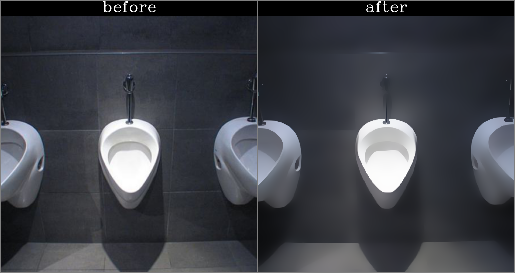

AssertionError: alpha is a matrix

In [7]:
results=run_peekaboo(
                    'left most toilet',
                     "/home/ubuntu/Detic/detic_input/6.jpg",
                     "/home/ubuntu/Detic/detic_input/6.pt",
                     # "/home/ubuntu/Detic/detic_op/final_mask_rgb.png",
                     representation='fourier bilateral', LEARNING_RATE=1e-04, GUIDANCE_SCALE=100, GRAVITY=.05,
                     # GUIDANCE_SCALE=100, GRAVITY=.05,
                     min_step=200,
                     max_step=600,
                     NUM_ITER=300,
                     bilateral_kwargs={'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}
                     )

<Cell: Get Hyperparameters>


ic| GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 300
    LEARNING_RATE: 0.0001
    GUIDANCE_SCALE: 100
    representation: 'fourier bilateral'
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}
    square_image_method: 'crop'


The bilateral blur applied to the input image before/after, to visualize it


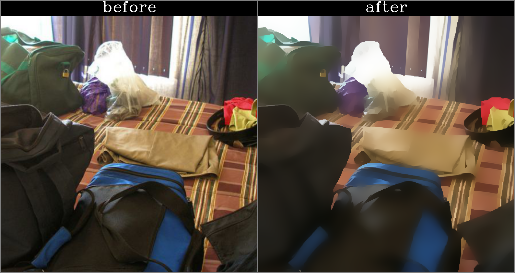

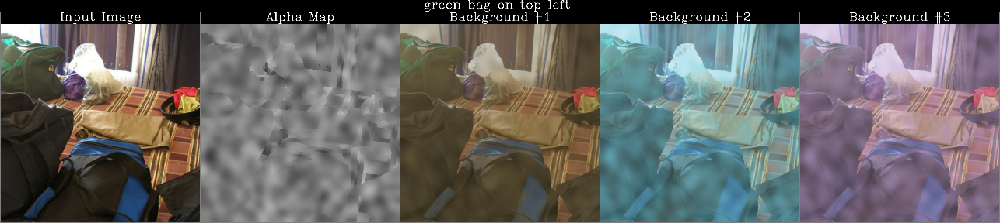

Will show preview images every 30 iterations


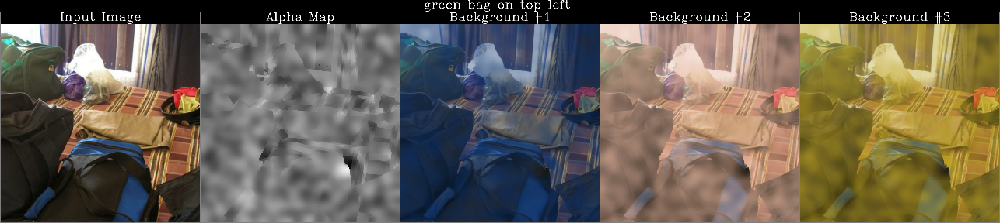

r.eta: ETR=0:07:45.767602	ETA=0:08:37.519557	T=0:00:51.751956	Progress: 30/300

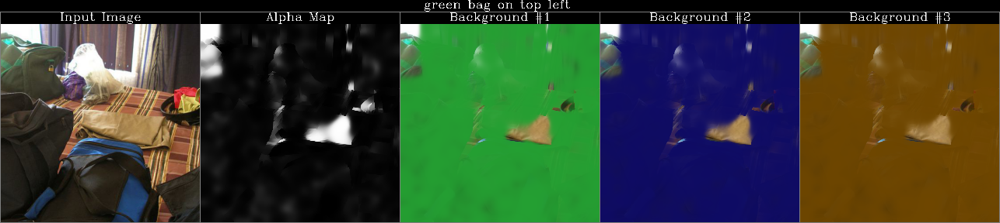

r.eta: ETR=0:06:28.029338	ETA=0:08:05.036672	T=0:01:37.007334	Progress: 60/300

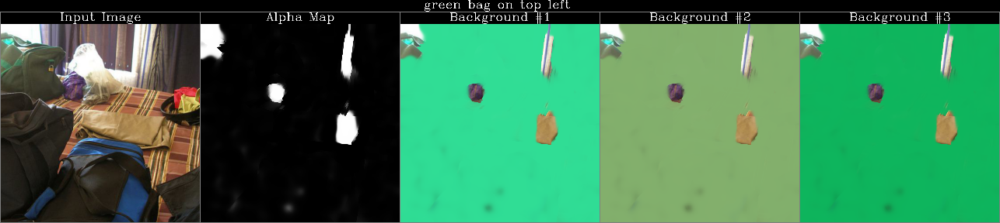

r.eta: ETR=0:05:28.013173	ETA=0:07:48.590247	T=0:02:20.577074	Progress: 90/300

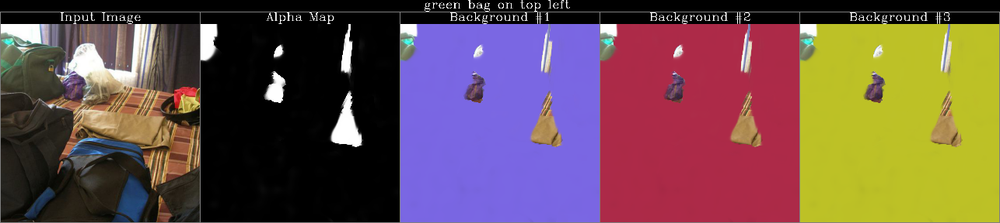

r.eta: ETR=0:04:36.621320	ETA=0:07:41.035533	T=0:03:04.414213	Progress: 120/300

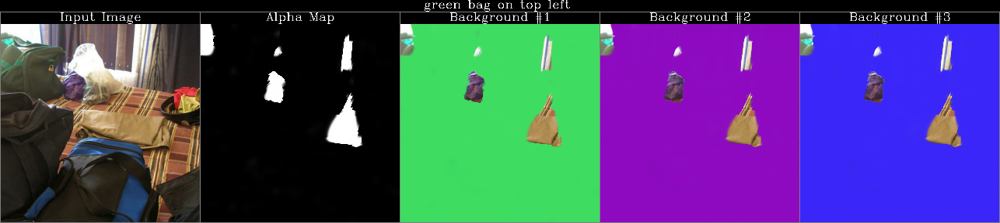

r.eta: ETR=0:03:46.499712	ETA=0:07:32.999424	T=0:03:46.499712	Progress: 150/300

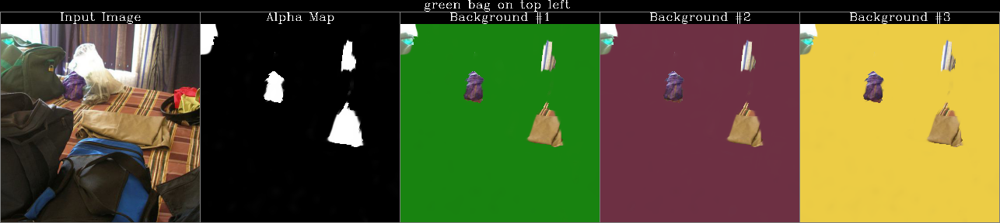

r.eta: ETR=0:03:00.971837	ETA=0:07:32.429592	T=0:04:31.457755	Progress: 180/300

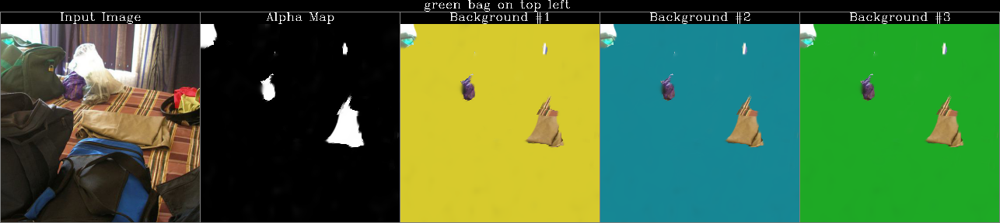

r.eta: ETR=0:02:14.639372	ETA=0:07:28.797906	T=0:05:14.158534	Progress: 210/300

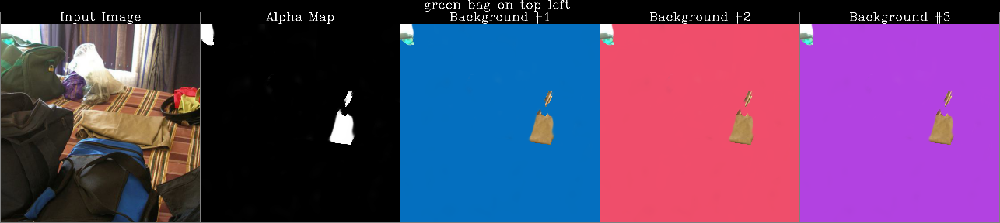

r.eta: ETR=0:01:29.800127	ETA=0:07:29.000636	T=0:05:59.200509	Progress: 240/300

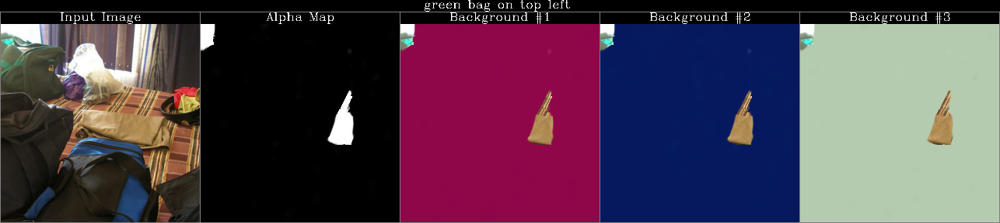

r.eta: ETR=0:01:09.551778	ETA=0:07:33.598550	T=0:06:24.046772	Progress: 254/300

In [ ]:
results=run_peekaboo(
                    'green bag on top left ',
                     "/home/ubuntu/refer/test_sm.jpg",
                     # "/home/ubuntu/Detic/detic_op/final_mask_rgb.png",
                     representation='fourier bilateral', LEARNING_RATE=1e-04, GUIDANCE_SCALE=100, GRAVITY=.05,
                     # GUIDANCE_SCALE=100, GRAVITY=.05,
                     min_step=200,
                     max_step=600,
                     NUM_ITER=300,
                     bilateral_kwargs={'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}
                     )

Once 
 
 Loop 
 
 Reflect

ic| name: 'apple logo on the laptop'
    label: SimpleLabel(name=apple logo on the laptop)
    image_path: '/home/ubuntu/Detic/detic_op/laptop.png'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 200
    GUIDANCE_SCALE: 200
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}


Saved results at peekaboo_results/apple logo on the laptop/002
<Cell: Get Hyperparameters>


ic| GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 200
    LEARNING_RATE: 0.1
    GUIDANCE_SCALE: 200
    representation: 'raster bilateral'
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}
    square_image_method: 'crop'


The bilateral blur applied to the input image before/after, to visualize it


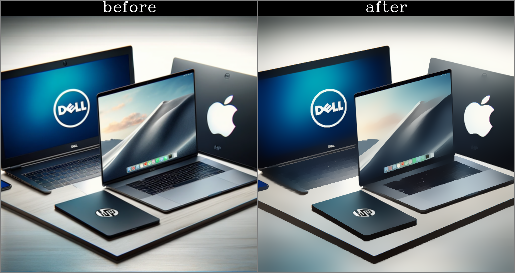

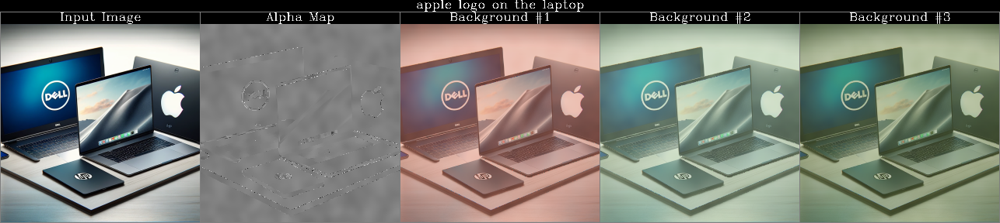

Will show preview images every 20 iterations


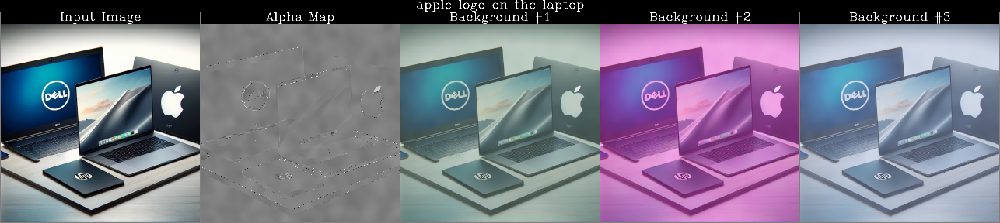

r.eta: ETR=0:04:07.552146	ETA=0:04:35.057940	T=0:00:27.505794	Progress: 20/200

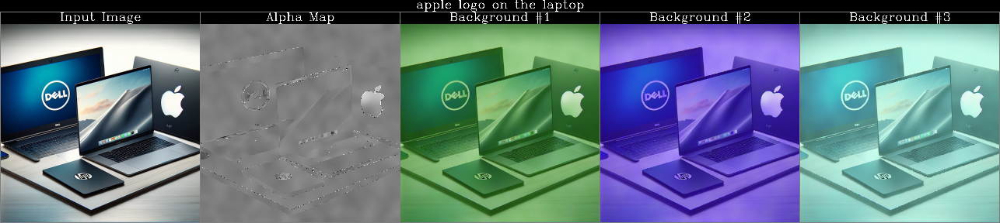

r.eta: ETR=0:03:40.230514	ETA=0:04:35.288142	T=0:00:55.057628	Progress: 40/200

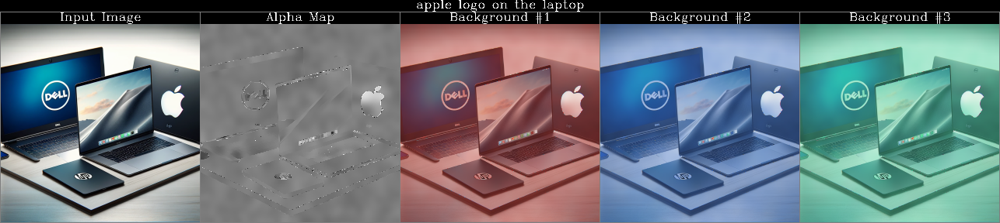

r.eta: ETR=0:03:25.976379	ETA=0:04:36.478362	T=0:01:10.501982	Progress: 51/200

In [ ]:
results_collection = []
for _ in range(10):
    results=run_peekaboo('apple logo on the laptop',
                         "/home/ubuntu/Detic/detic_op/laptop.png",
                         representation='raster bilateral', LEARNING_RATE=1e-01, GUIDANCE_SCALE=200, GRAVITY=.05,
                         min_step=200,
                         max_step=500,
                         NUM_ITER=200,
                         )
    results_collection.append(results)



In [ ]:
peekaboo.s.min_step=200
peekaboo.s.max_step=600

#Mario vs Luigi Part 1
results=run_peekaboo(
    # 'Luigi', #200/600
    # 'Princess Peach', #200/600H, 
    # 'Mario',
    # 'Bowser from super smash bros; yellow shell; seen from the front', #NO; stable diffusion is too weak to draw this - or I have bad prompts
    
    
                     # "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                     # "http://images6.fanpop.com/image/photos/43400000/Mario-Peach-super-mario-bros-43431011-644-704.png",
                                         
                     # bilateral_kwargs=dict(kernel_size = 3,
                     #                  tolerance = .08,
                     #                  sigma = 5,
                     #                  iterations=2,
                     #                 ),
                     # representation='raster',
    
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [48]:
#Mario vs Luigi Part 1
peekaboo.s.min_step, peekaboo.s.max_step=200,600
results=run_peekaboo('Mario',
                     "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=100,  GRAVITY=.05, min_step=200,
                         max_step=400,
                     )

Once 
 
 Loop 
 
 Reflect

ic| name: 'Mario'
    label: SimpleLabel(name=Mario)
    image_path: 'https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 100
    GUIDANCE_SCALE: 200
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08

Saved results at peekaboo_results/Mario/002


}


In [ ]:
#Mario vs Luigi Part 2
results=run_peekaboo('Luigi',
                     "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                     )

In [53]:
#Mario vs Luigi Part 2
label = peekaboo.SimpleLabel('Luigi')
blend_factor=.5
peekaboo.s.min_step, peekaboo.s.max_step=200,600
label.embedding = label.embedding*(1+blend_factor) - peekaboo.SimpleLabel('Mario').embedding*blend_factor
results=run_peekaboo('Luigi',
                     "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                     label=label,
                     min_step=200,
                     max_step=500,
                     NUM_ITER=150,
                     )

Once 
 
 Loop 
 
 Reflect

ic| name: 'Luigi'
    label: SimpleLabel(name=Luigi)
    image_path: 'https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 150
    GUIDANCE_SCALE: 100
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}


Saved results at peekaboo_results/Luigi/031


In [ ]:
#Mario vs Luigi Part 2
label = peekaboo.SimpleLabel('Luigi')
blend_factor=.5
# peekaboo.s.min_step, peekaboo.s.max_step=200,600

label.embedding = label.embedding*(1+blend_factor) - peekaboo.SimpleLabel('Mario').embedding*blend_factor
results=run_peekaboo('Luigi',
                     "https://i1.sndcdn.com/artworks-000160550668-iwxjgo-t500x500.jpg",
                     label=label,
                     min_step=200,
                     max_step=600,
                     NUM_ITER=100,
                     )

In [ ]:
peekaboo.s.min_step,peekaboo.s.max_step=200,400
#Wine and Cheese Part 1
results=run_peekaboo('Wine Glass half-full',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [ ]:
peekaboo.s.min_step,peekaboo.s.max_step=200,600
#Wine and Cheese Part 1
results=run_peekaboo('Wine Glass half-full',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [ ]:
peekaboo.s.min_step,peekaboo.s.max_step=200,400
#Wine and Cheese Part 2
results=run_peekaboo('Swiss Cheese',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [ ]:
peekaboo.s.min_step,peekaboo.s.max_step=200,600
#Wine and Cheese Part 2
results=run_peekaboo('Swiss Cheese',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [ ]:
# https://americasrestaurant.com/wp-content/uploads/2022/04/what-do-bread-and-butter-pickles-taste-like.jpg
peekaboo.s.min_step,peekaboo.s.max_step=200,600
#Wine and Cheese Part 3
results=run_peekaboo(
    # 'piano keyboard',
    # 'violin',
    'brass shiny saxophone on top',
                     "https://c8.alamy.com/comp/2GFDH27/violin-with-saxophone-and-piano-closeup-2GFDH27.jpg",
                     # representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [ ]:
for _ in range(10):
    results=run_peekaboo(
        'Nemo Clownfish',
        'https://akns-images.eonline.com/eol_images/Entire_Site/2016917/rs_600x600-161017135949-600.finding-dory-2.101716.jpg',
        representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200,
        min_step=200, max_step=600,
        GRAVITY=.05,
        NUM_ITER=200,
    )
    results_collection.append(results)

In [ ]:
for _ in range(10):
    results=run_peekaboo(
        'brass shiny saxophone on top',
        "https://c8.alamy.com/comp/2GFDH27/violin-with-saxophone-and-piano-closeup-2GFDH27.jpg",
        representation='raster bilateral',
        LEARNING_RATE=1e-0,
        GUIDANCE_SCALE=200,
        min_step=200,
        max_step=900,
        GRAVITY=.05,
        NUM_ITER=200,
    )
    results_collection.append(results)

In [9]:
run_peekaboo(
        'Nemo Clownfish',
        'https://akns-images.eonline.com/eol_images/Entire_Site/2016917/rs_600x600-161017135949-600.finding-dory-2.101716.jpg',
        representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200,
        min_step=200, max_step=600,
        GRAVITY=.05,
        NUM_ITER=200,
    )

Once 
 
 Loop 
 
 Reflect

ic| name: 'Nemo Clownfish'
    label: SimpleLabel(name=Nemo Clownfish)
    image_path: 'https://akns-images.eonline.com/eol_images/Entire_Site/2016917/rs_600x600-161017135949-600.finding-dory-2.101716.jpg'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 200
    GUIDANCE_SCALE: 200
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}


Saved results at peekaboo_results/Nemo Clownfish/000


{'alphas': array([[[0.585, 0.577, 0.559, ..., 0.882, 0.881, 0.881],
         [0.581, 0.573, 0.555, ..., 0.879, 0.878, 0.878],
         [0.571, 0.564, 0.546, ..., 0.873, 0.872, 0.872],
         ...,
         [0.096, 0.093, 0.089, ..., 0.076, 0.051, 0.042],
         [0.099, 0.097, 0.092, ..., 0.074, 0.05 , 0.042],
         [0.1  , 0.099, 0.095, ..., 0.082, 0.04 , 0.039]]], dtype=float32),
 'GRAVITY': 0.05,
 'BATCH_SIZE': 1,
 'NUM_ITER': 200,
 'GUIDANCE_SCALE': 200,
 'bilateral_kwargs': {'kernel_size': 3,
  'tolerance': 0.08,
  'sigma': 5,
  'iterations': 40},
 'representation': 'raster bilateral',
 'label': SimpleLabel(name=Nemo Clownfish),
 'image': array([[[0.136, 0.206, 0.206],
         [0.141, 0.211, 0.211],
         [0.144, 0.214, 0.214],
         ...,
         [0.172, 0.791, 0.827],
         [0.172, 0.791, 0.827],
         [0.165, 0.795, 0.827]],
 
        [[0.116, 0.187, 0.187],
         [0.121, 0.191, 0.191],
         [0.127, 0.197, 0.197],
         ...,
         [0.164, 0.783, 0

In [ ]:
peekaboo.s.min_step,peekaboo.s.max_step=200,400
#Wine and Cheese Part 3
results=run_ipeekaboo('grapes',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

In [8]:
peekaboo.s.min_step,peekaboo.s.max_step=200,600
#Wine and Cheese Part 3
results=run_peekaboo('Green grapes',
                     "https://emeraldvalleyartisans.com/wp-content/uploads/2015/10/winecheese1.jpg",
                     representation='raster bilateral', LEARNING_RATE=1e-0, GUIDANCE_SCALE=200, NUM_ITER=500,  GRAVITY=.05,
                     )

ConnectionError: HTTPSConnectionPool(host='emeraldvalleyartisans.com', port=443): Max retries exceeded with url: /wp-content/uploads/2015/10/winecheese1.jpg (Caused by NewConnectionError('<urllib3.connection.HTTPSConnection object at 0x7fe23ba42700>: Failed to establish a new connection: [Errno 110] Connection timed out'))

In [ ]:
#Harry Potter Part 1
results=run_peekaboo('Harry Potter boy - daniel radcliffe - man with glasses',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     NUM_ITER=300
                    )

In [ ]:
#Harry Potter Part 2
label = peekaboo.SimpleLabel('Hermoine Granger')
blend_factor=.5
label.embedding = label.embedding*(1+blend_factor) - peekaboo.SimpleLabel('Harry Potter').embedding*blend_factor
results=run_peekaboo('Hermoine',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     label=label
                     )


In [ ]:
#Harry Potter Part 2
label = peekaboo.SimpleLabel('Hermoine Granger - Emma Watson - Girl with long hair')
blend_factor=.5
label.embedding = label.embedding*(1+blend_factor) - peekaboo.SimpleLabel('Harry Potter boy - daniel radcliffe - man with glasses').embedding*blend_factor

results=run_peekaboo('Hermoine',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     label=label
                     )

In [ ]:
#Emma Watson
#Good in a row: |||
#Bad prompts: "Hermoine Granger aka Emma Watson"
results=run_peekaboo('Hermoine Granger - Emma Watson - Girl with long hair',
                     "https://cometothedarkside97.files.wordpress.com/2021/05/images-2020-01-25t073939.551.jpeg?w=468",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [ ]:
#Emma Watson
#Good in a row: 
#Bad prompts: 
results=run_peekaboo('Harry Potter boy - daniel radcliffe - man with glasses',
                     "https://prisiliaandayani.files.wordpress.com/2014/03/harry-ron-hermione-harry-potter-2422078-361-500.jpg",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [ ]:
#Good in a row with fixed timestep 500: H,H,
#Bad prompts: 

# peekaboo.s.min_step=100
# peekaboo.s.max_step=500
for _ in range(10):
    results=run_peekaboo(
        'Harry Potter boy - daniel radcliffe - man with glasses',
        # 'Hermoine Granger - Emma Watson - Girl with long hair',

                         "https://i.guim.co.uk/img/media/380500f7fd9321a6cfd1bd1a3b3f104ad9797bb7/0_0_2000_1199/master/2000.jpg?width=1200&height=1200&quality=85&auto=format&fit=crop&s=f0d0ecb5a0c33aa91be270b08619e8d7",
                            # "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                         # "https://prisiliaandayani.files.wordpress.com/2014/03/harry-ron-hermione-harry-potter-2422078-361-500.jpg",

                         representation='raster bilateral',
                         # representation='raster',
                         # bilateral_kwargs=dict(kernel_size = 3,
                         #                  tolerance = .08,
                         #                  sigma = 5,
                         #                  iterations=2,
                         #                 ),
                         # representation='raster',
                         LEARNING_RATE=1e-0,
                         GUIDANCE_SCALE=200,
                         min_step=200,
                         max_step=400,
                         GRAVITY=.05,
                         NUM_ITER=200,
                         )
    results_collection.append(results)

In [ ]:
#Emma Watson
#Good in a row: ||X2X
#Good in a row with fixed timestep: |||||
#Bad prompts: 
results=run_peekaboo('Hermoine Granger - Emma Watson - Girl with long hair',
                     "https://i.guim.co.uk/img/media/380500f7fd9321a6cfd1bd1a3b3f104ad9797bb7/0_0_2000_1199/master/2000.jpg?width=1200&height=1200&quality=85&auto=format&fit=crop&s=f0d0ecb5a0c33aa91be270b08619e8d7",
                     representation='raster bilateral',
                     # bilateral_kwargs=dict(kernel_size = 3,
                     #                  tolerance = .08,
                     #                  sigma = 5,
                     #                  iterations=2,
                     #                 ),
                     # representation='raster',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [ ]:
#Emma Watson
#Good in a row: |||
#Bad prompts: "Emma Watson"
results=run_peekaboo('Hermoine Granger aka Emma Watson',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [ ]:
#Harry Potter 
#Good in a row: ||
results=run_peekaboo('Daniel radcliffe',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [ ]:
#Harry Potter 
#Good in a row: |||||
results=run_peekaboo('Harry Potter boy - daniel radcliffe - man with glasses',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     )

In [57]:
#Mario vs Luigi Part 1
#Good in a row: |||||
results=run_peekaboo('Hermoine Granger - Emma Watson - Girl with long hair',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     representation='raster bilateral',
                     LEARNING_RATE=1e-0,
                     GRAVITY=.05,
                     min_step=200,
                     max_step=500,
                     NUM_ITER=150,
                     )

Once 
 
 Loop 
 
 Reflect

ic| name: 'Hermoine Granger - Emma Watson - Girl with long hair'
    label: SimpleLabel(name=Hermoine Granger - Emma Watson - Girl with long hair)
    image_path: 'https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG'
    GRAVITY: 0.05
    BATCH_SIZE: 1
    NUM_ITER: 150
    GUIDANCE_SCALE: 100
    bilateral_kwargs: {'iterations': 40, 'kernel_size': 3, 'sigma': 5, 'tolerance': 0.08}


Saved results at peekaboo_results/Hermoine Granger - Emma Watson - Girl with long hair/001


In [ ]:
#Harry Potter Part 2
results=run_peekaboo('Hermoine Granger - Emma Watson - Girl with long hair - left',
                     "https://assets.teenvogue.com/photos/569e7d2a74da98670ff0ce1c/1:1/w_2159,h_2159,c_limit/MCDHAPO_EC797_H.JPG",
                     NUM_ITER=300
                    )

In [ ]:
#Stable Diffusion Basic Demo
#This is a demo cell showing how to simply use Stable Diffusion to generate an image. This is usefull for prompt engineering.
rp.display_image(peekaboo.s.prompt_to_img('Cake'))

In [54]:
#Stable Diffusion Basic Demo
#This is a demo cell showing how to simply use Stable Diffusion to generate an image. This is usefull for prompt engineering.
for _ in range(30):
    rp.display_image(peekaboo.s.prompt_to_img('Bowser from super smash bros; yellow shell; seen from the front'))

/home/ubuntu/peekaboo-v2/source/stable_diffusion.py:130: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = torch.randn((num_prompts, self.unet.in_channels, height // 8, width // 8), device=self.device)


AttributeError: __enter__

In [9]:
import torch
torch.cuda.is_available()

True